In [1]:
# !pip install tensorflow opencv-python

In [2]:
import os
import cv2
import shutil
import pickle
import numpy as np
from random import sample
from ultralytics import YOLO
import matplotlib.pyplot as plt
from keras.layers import Flatten
from IPython.display import display, Image
from sklearn.metrics.pairwise import cosine_similarity
from keras.applications.vgg19 import VGG19, preprocess_input

In [3]:
if not os.path.exists('./shop'):
    os.mkdir('./shop')

    path = os.path.join(os.getcwd(), 'images')
    genders = os.listdir(path)
    for gender in genders:
        items = os.listdir(os.path.join(path, gender))
        for item in items:
            ids = os.listdir(os.path.join(path, gender, item))
            for id in ids:
                image_path = os.path.join(path, gender, item, id)
                images = os.listdir(image_path)
                images.sort()
                
                if len(images)==0: continue
                
                new_path = os.path.join(os.getcwd(), 'shop', gender, item)
                os.makedirs(new_path, exist_ok=True)
                
                shutil.copy(os.path.join(image_path, images[0]), os.path.join(new_path, f'{id} {images[0]}'))

In [4]:
model_pretrained = VGG19(input_shape=(256, 256, 3),
                         include_top=False,
                         weights='imagenet')


def feature_extractor(x, actual_file=False):
    if not actual_file:
        x = cv2.imread(x)
        if x is None or x.size == 0:
            raise ValueError("Invalid image file or empty image")
        # x = cv2.cvtColor(x, cv2.COLOR_BGR2RGB)  # uncomment this line if needed
        x = cv2.resize(x, (256, 256), interpolation=cv2.INTER_AREA)
    x = np.expand_dims(x, axis=0)
    x = preprocess_input(x)
    features = model_pretrained.predict(x)
    return Flatten()(features).numpy()

In [5]:
classes = ['top',
           'top',
           'outwear',
           'outwear',
           'vest',
           'vest',
           'shorts',
           'trousers',
           'skirts',
           'dress',
           'dress',
           'dress',
           'dress']

model = YOLO('./runs/detect/train3/weights/best.pt')


def predict(frame):
    frame = cv2.imread(frame)
    result = {}

    results = model.predict(frame, conf=0.4)
    labels = results[0].boxes.cls.tolist()
    boxes = results[0].boxes.data.tolist()

    if len(labels) == 0:
        print("No object detected. Please try another image!")
        return

    for i in range(0, len(labels)):
        label = classes[int(labels[i])]
        left, top, width, height, _, _ = boxes[i]
        left = int(left)
        top = int(top)
        width = int(width)
        height = int(height)
        resize = frame[top:top+height, left:left+width, :]
        resize = cv2.resize(resize, (256, 256), interpolation=cv2.INTER_AREA)
        result[label] = feature_extractor(resize, actual_file=True)

    return result

In [6]:
categories = {
    'top': ['MEN/Shirts_Polos', 'MEN/Tees_Tanks', 'MEN/Sweaters', 'WOMEN/Blouses_Shirts', 'WOMEN/Graphic_Tees', 'WOMEN/Sweaters', 'WOMEN/Tees_Tanks'],
    'outwear': ['MEN/Sweatshirts_Hoodies', 'WOMEN/Cardigans', 'WOMEN/Jackets_Coats', 'WOMEN/Sweaters', 'WOMEN/Sweatshirts_Hoodies'],
    'vest': ['MEN/Jacket_Vests', 'WOMEN/Dresses', 'WOMEN/Jackets_Coats'],
    'shorts': ['MEN/Shorts', 'WOMEN/Shorts'],
    'trousers': ['MEN/Denim', 'MEN/Pants', 'WOMEN/Denim', 'WOMEN/Leggings', 'WOMEN/Pants'],
    'skirts': ['WOMEN/Skirts'],
    'dress': ['WOMEN/Dresses', 'WOMEN/Rompers_Jumpsuits'],
}

In [7]:
if not os.path.exists('./vector_images'):
    os.mkdir('./vector_images')

    path = os.path.join(os.getcwd(), 'shop')
    genders = os.listdir(path)
    for gender in genders:
        items = os.listdir(os.path.join(path, gender))
        for item in items:
            features = []
            order = []
            images = os.listdir(os.path.join(path, gender, item))
            for image in images:
                image_path = os.path.join(path, gender, item, image)
                feature = feature_extractor(str(image_path))
                features.append(feature)
                order.append(os.path.join(gender, item, image.split()[0]))
            
            os.makedirs(os.path.join(os.getcwd(), 'vector_images', gender, item), exist_ok=True)

            with open(os.path.join(os.getcwd(), 'vector_images', gender, item, f'{item}.npy'), 'wb') as f:
                np.save(f,np.array(features))
            with open(os.path.join(os.getcwd(), 'vector_images', gender, item, f'{item}.txt'), "wb") as fp:
                pickle.dump(order, fp)

In [8]:
def recommender(result, no_of_rec):
    match = {}

    for category, feature in result.items():
        similarity_score = []
        target = []
        feature = np.array(feature).reshape(1, -1)

        for shop_item in categories[category]:
            vector_path = os.path.join(os.getcwd(), 'vector_images', shop_item)
            with open(os.path.join(vector_path, f'{shop_item.split("/")[-1]}.npy'), 'rb') as f:
                shop_item_features = np.load(f)
            with open(os.path.join(vector_path, f'{shop_item.split("/")[-1]}.txt'), 'rb') as fp:
                saved_txt = pickle.load(fp)

            similarity_score.extend(cosine_similarity(lists, feature)[0][0] for lists in shop_item_features)
            target.extend(saved_txt)

        similarity_score = np.array(similarity_score)
        target = np.array(target).reshape(-1)

        match[category] = target[np.argsort(similarity_score)[::-1][:no_of_rec]]

    return match

In [9]:
def show_recommendation(match):
    for classname, images in match.items():
        for i, image in enumerate(images):
            print(f'\nArticle - {i+1}')
            shop_images = os.listdir(os.path.join(os.getcwd(), 'images', image))
            plt.figure(figsize=(20, 10))

            for j, img in enumerate(shop_images[:4]):
                plt.subplot(int(float('14'+str(j+1))))
                plt.axis('off')
                plt.title(img.split('_')[-1][:-4].title())
                plt.imshow(cv2.cvtColor(cv2.imread(os.path.join(os.getcwd(), 'images', image, img)), cv2.COLOR_BGR2RGB))

            plt.show()

In [10]:
# Remove all segment images from shop images
path = os.path.join(os.getcwd(), 'images')
genders = os.listdir(path)
for gender in genders:
    items = os.listdir(os.path.join(path, gender))
    for item in items:
        ids = os.listdir(os.path.join(path, gender, item))
        for id in ids:
            image_path = os.path.join(path, gender, item, id)
            images = os.listdir(image_path)
            for image in images:
                if 'segment' in image:
                    os.remove(os.path.join(image_path, image))


0: 640x640 1 long sleeve top, 1 trousers, 361.4ms
Speed: 8.0ms preprocess, 361.4ms inference, 8.0ms postprocess per image at shape (1, 3, 640, 640)


1/1 [==============================] - 0s 313ms/step


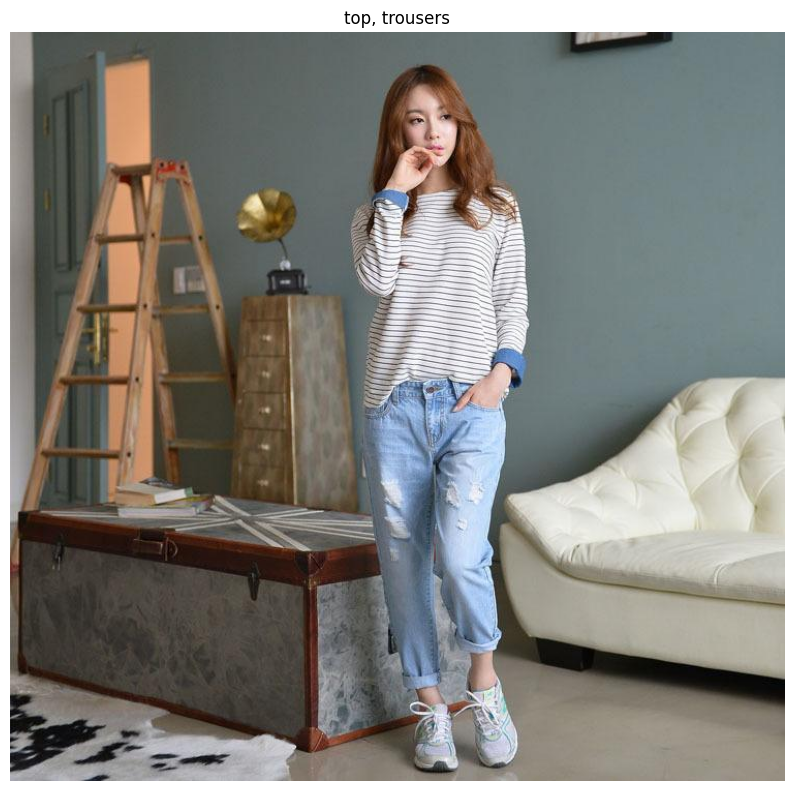


Article - 1


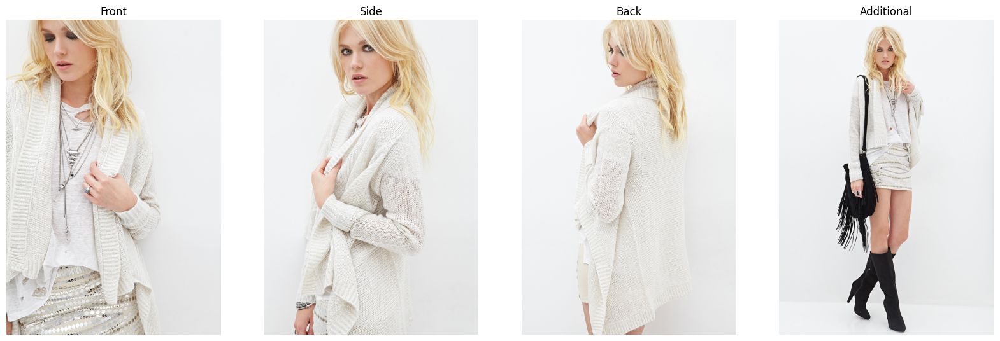


Article - 2


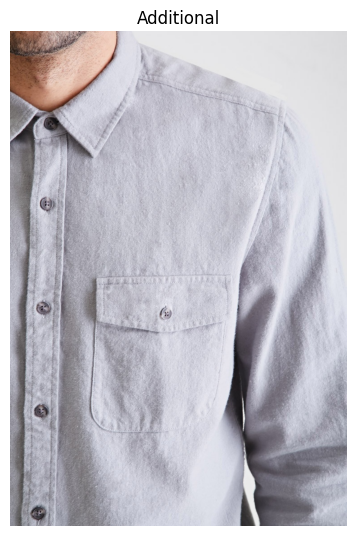


Article - 3


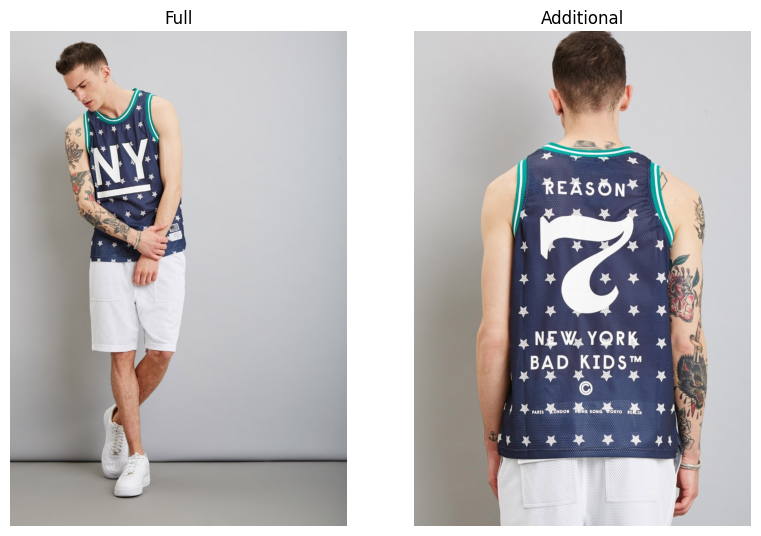


Article - 1


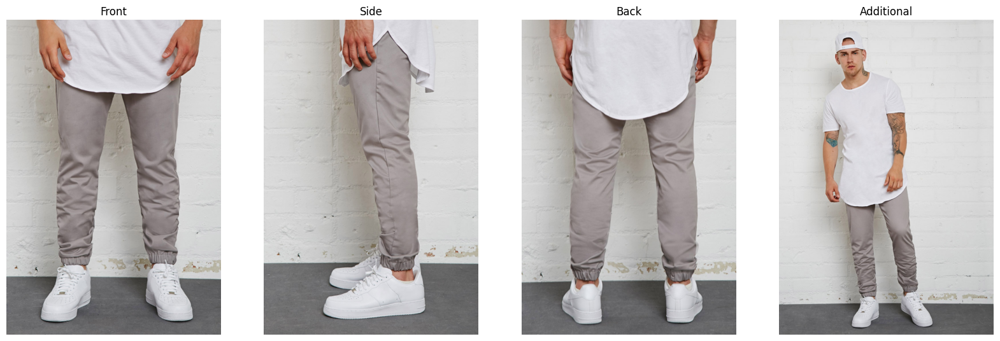


Article - 2


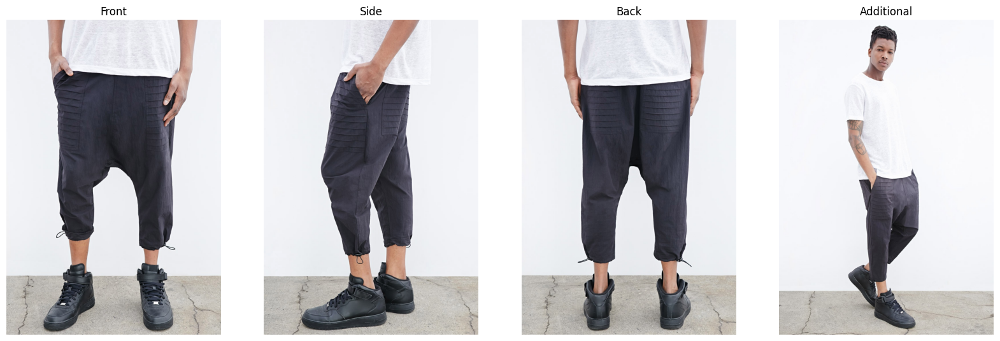


Article - 3


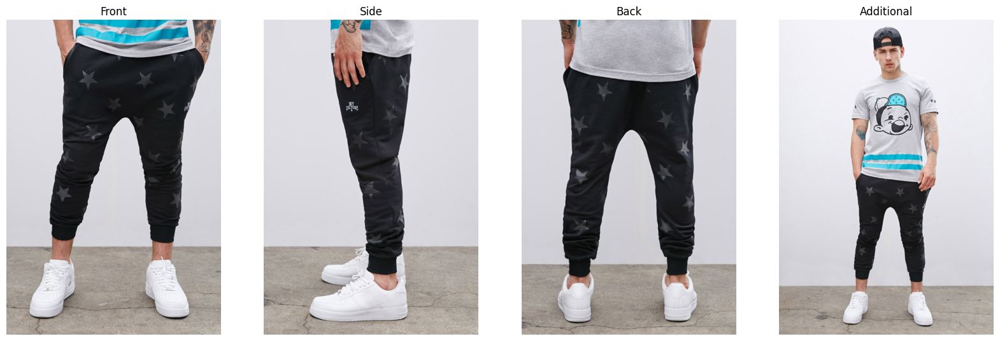


0: 640x448 1 short sleeve top, 1 skirt, 321.6ms
Speed: 0.0ms preprocess, 321.6ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


1/1 [==============================] - 0s 358ms/step


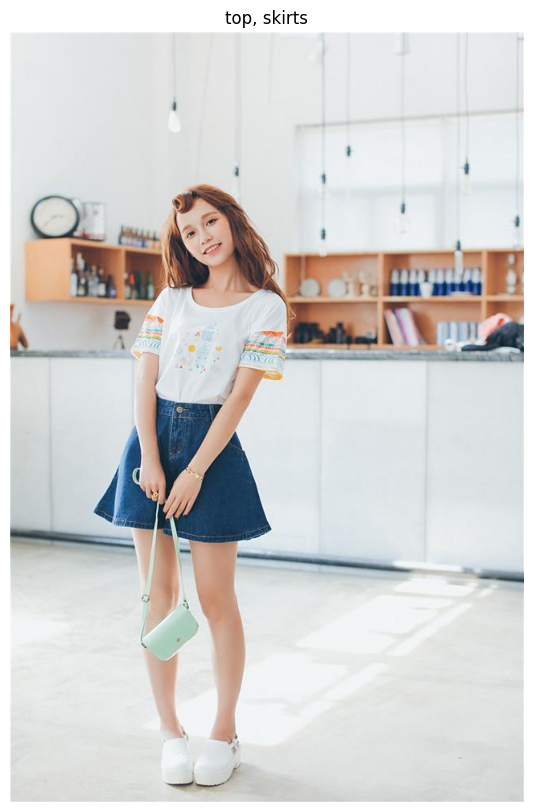


Article - 1


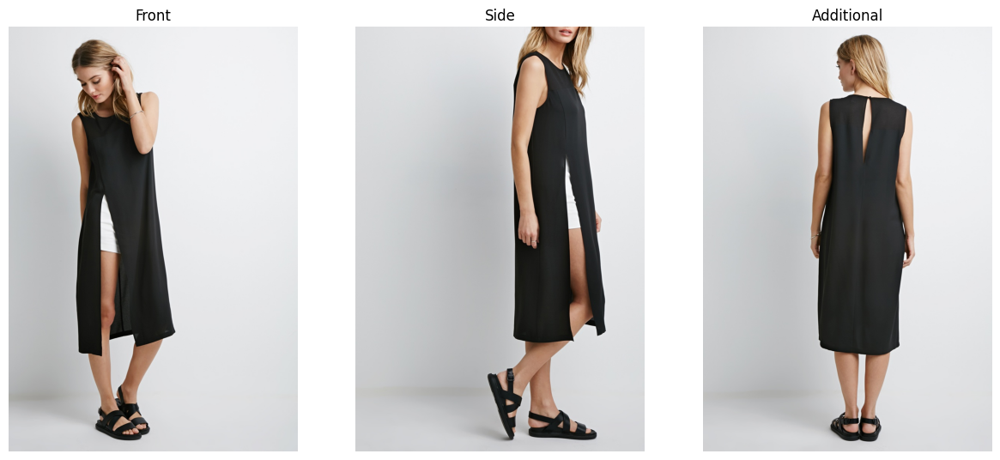


Article - 2


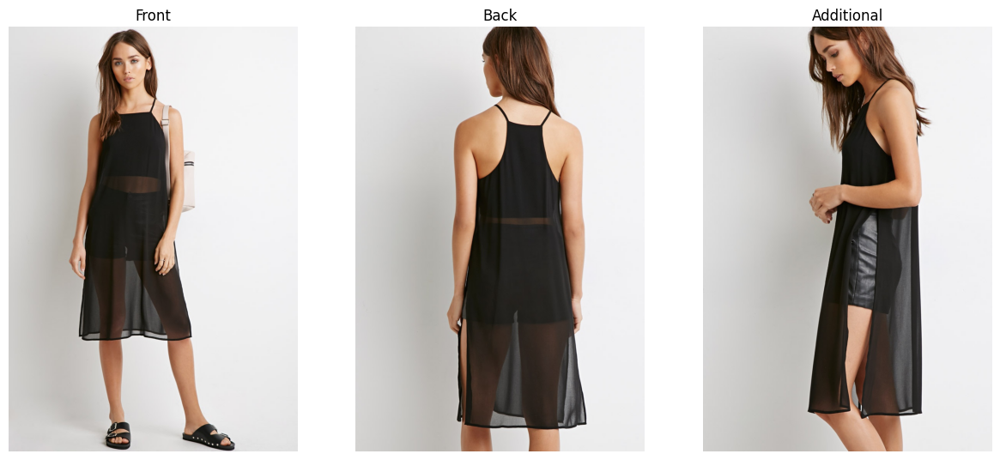


Article - 3


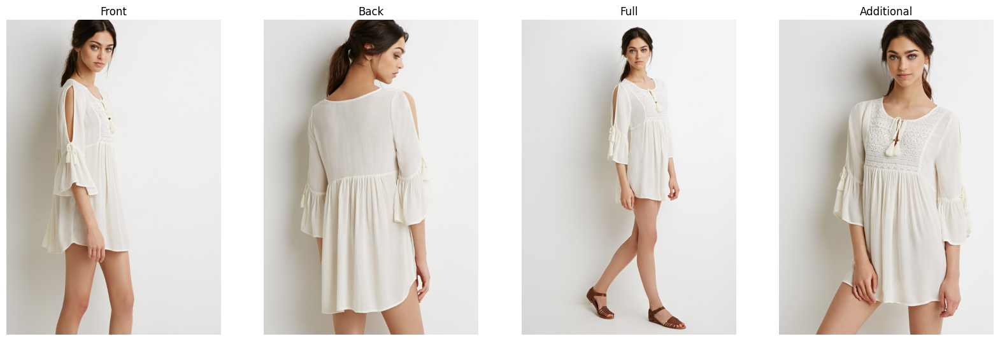


Article - 1


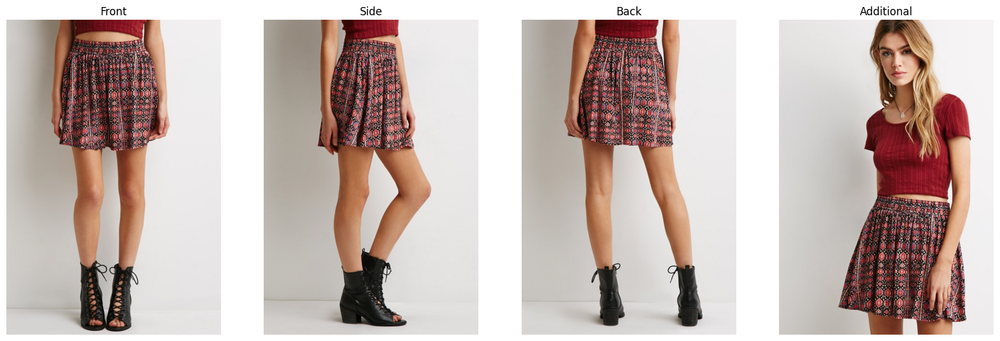


Article - 2


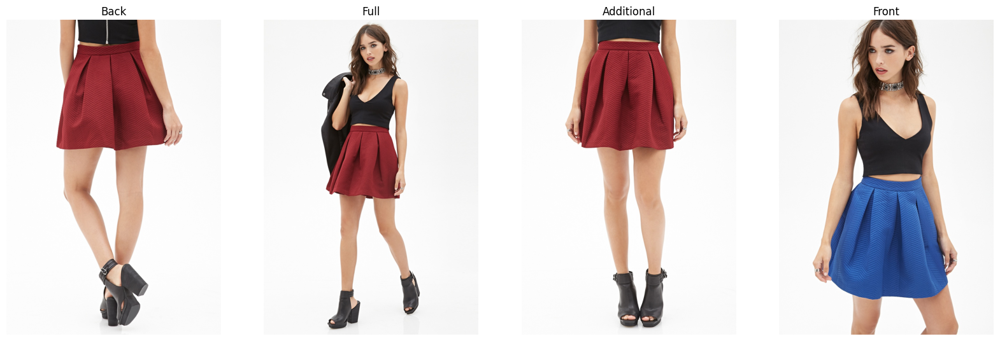


Article - 3


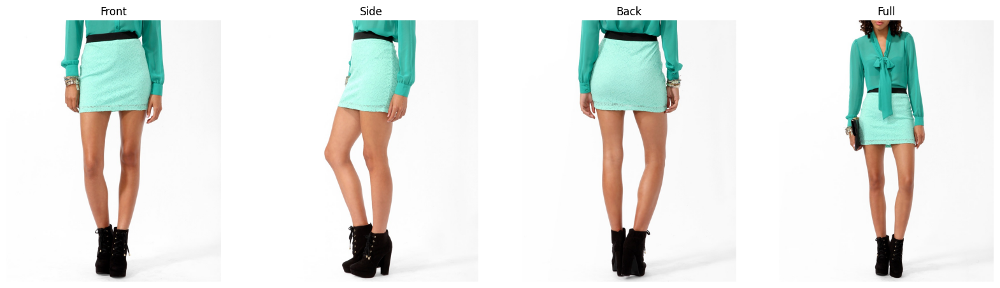


0: 544x640 1 short sleeve top, 1 shorts, 1 trousers, 411.5ms
Speed: 1.5ms preprocess, 411.5ms inference, 8.0ms postprocess per image at shape (1, 3, 640, 640)


1/1 [==============================] - 0s 356ms/step


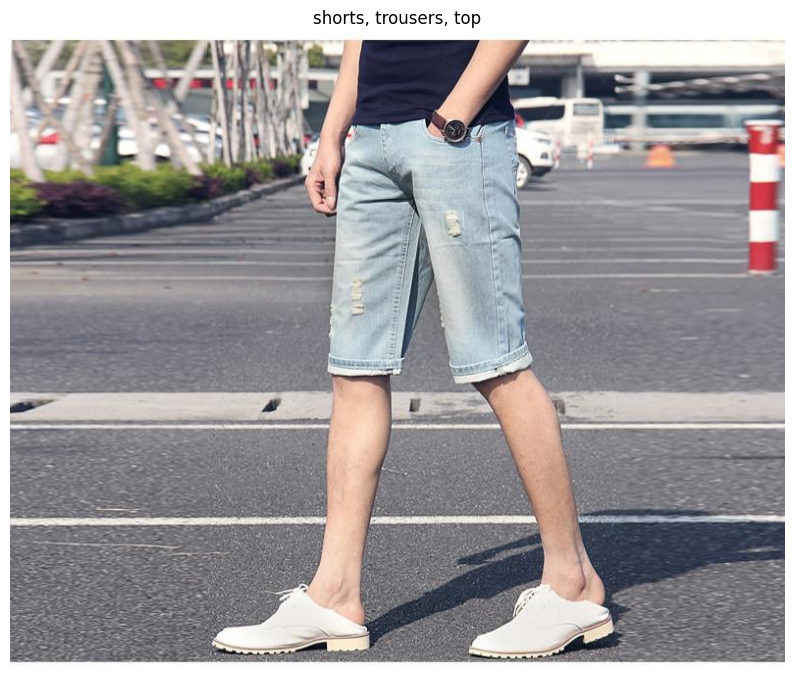


Article - 1


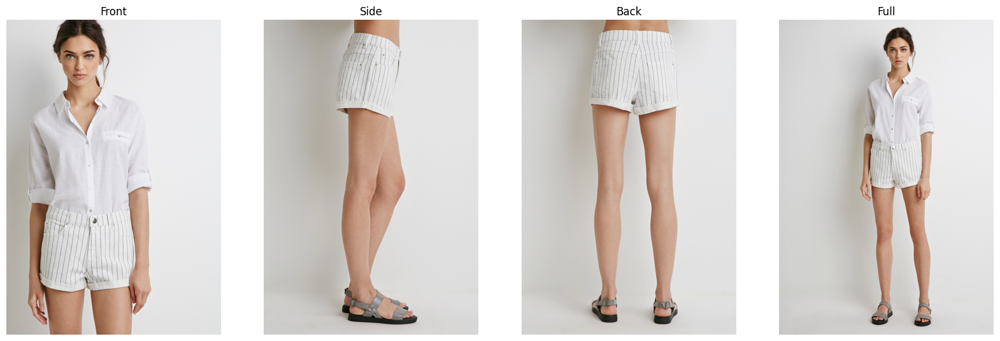


Article - 2


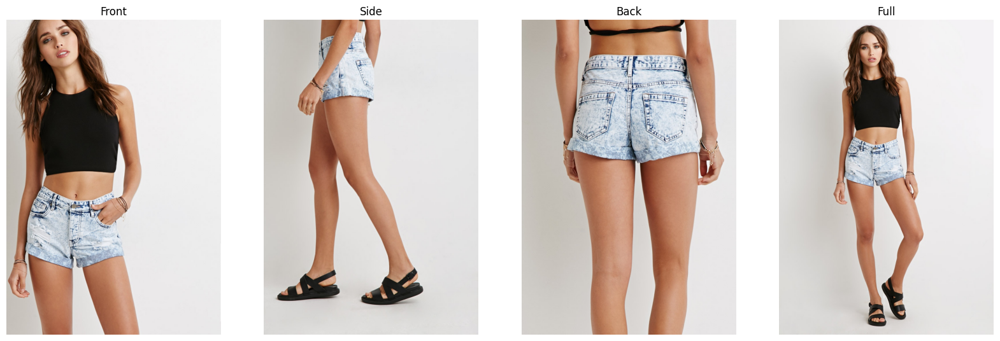


Article - 3


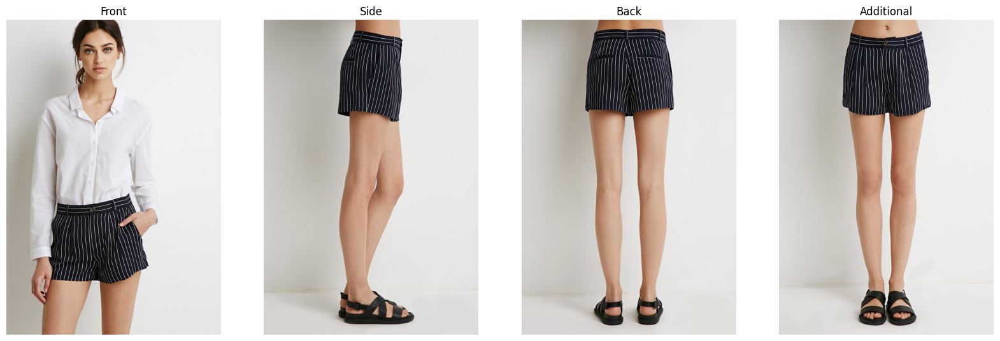


Article - 1


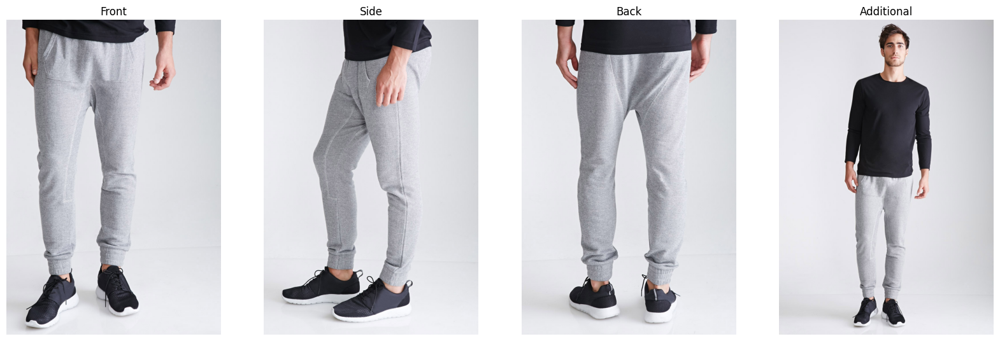


Article - 2


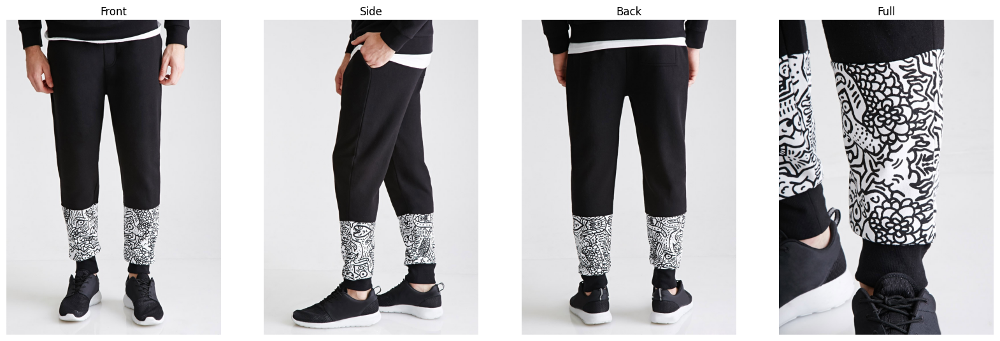


Article - 3


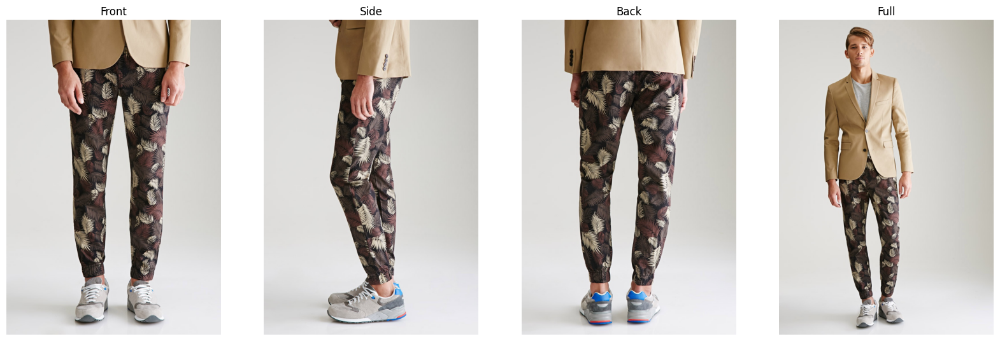


Article - 1


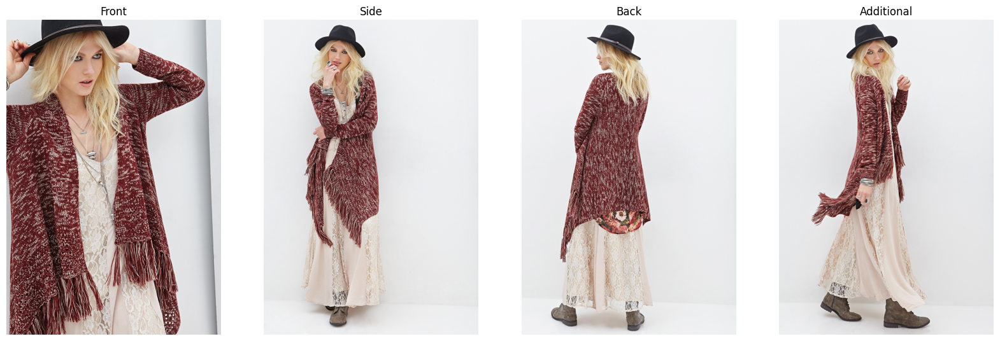


Article - 2


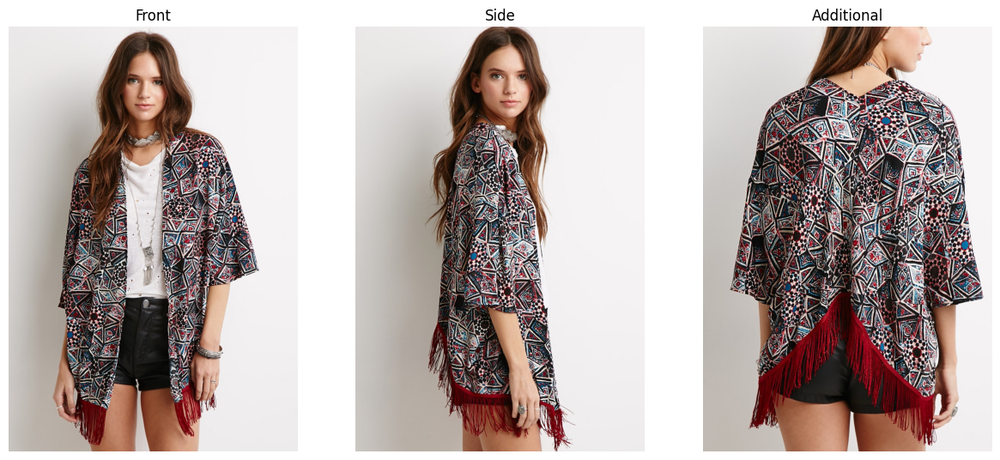


Article - 3


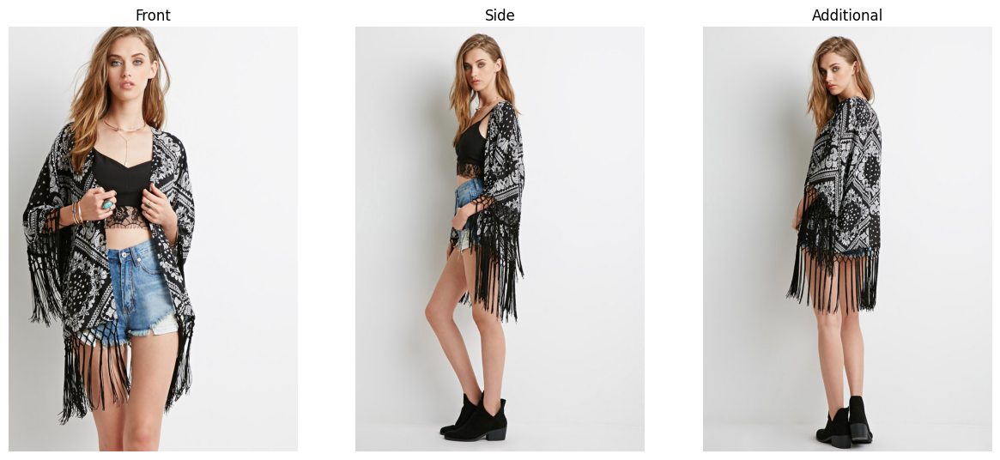


0: 640x480 1 long sleeve top, 1 skirt, 361.7ms
Speed: 4.5ms preprocess, 361.7ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


1/1 [==============================] - 0s 438ms/step


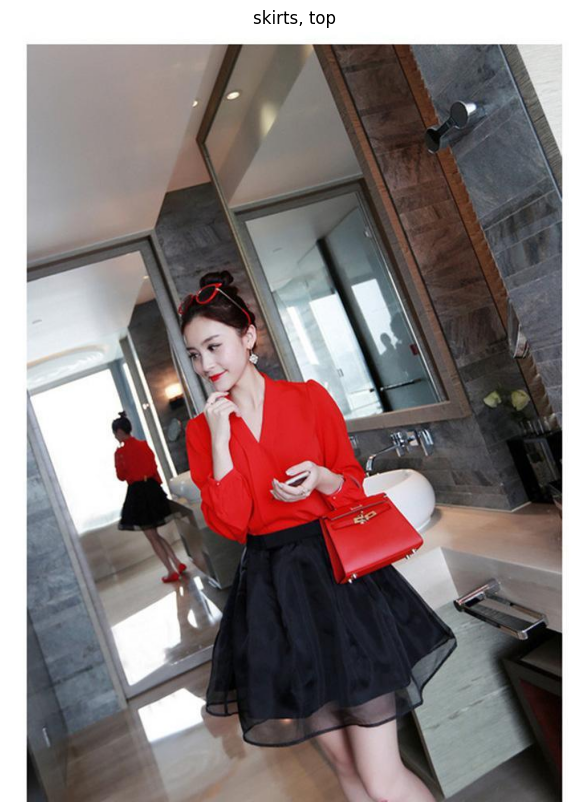


Article - 1


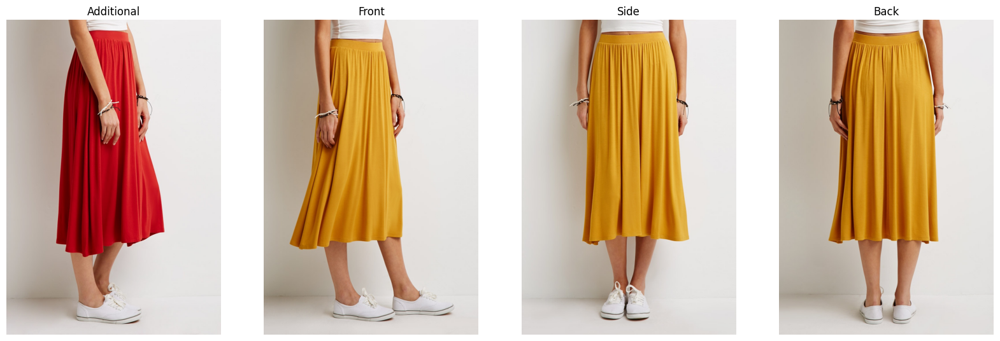


Article - 2


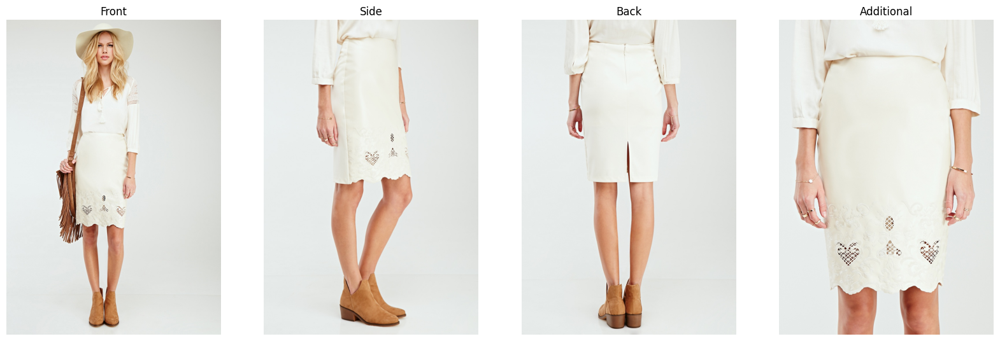


Article - 3


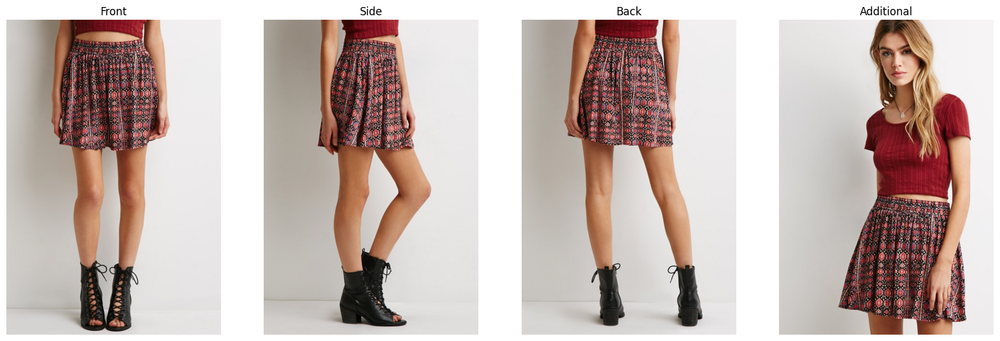


Article - 1


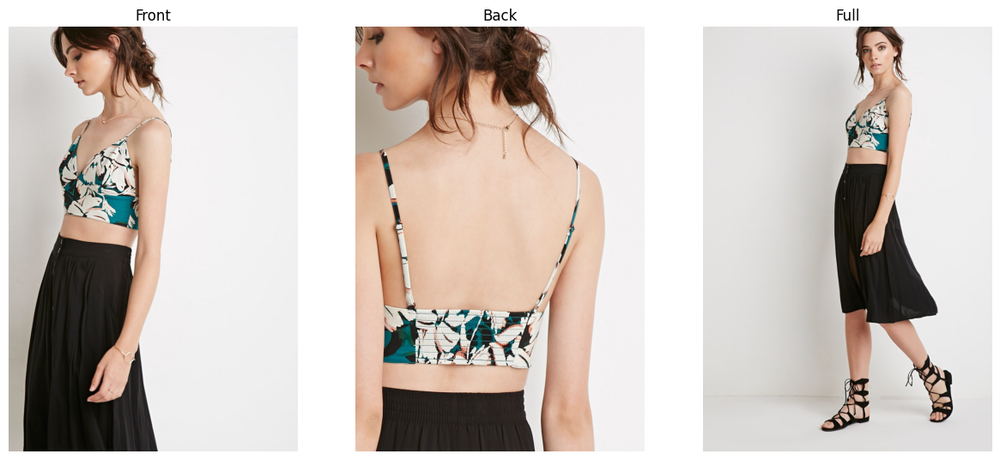


Article - 2


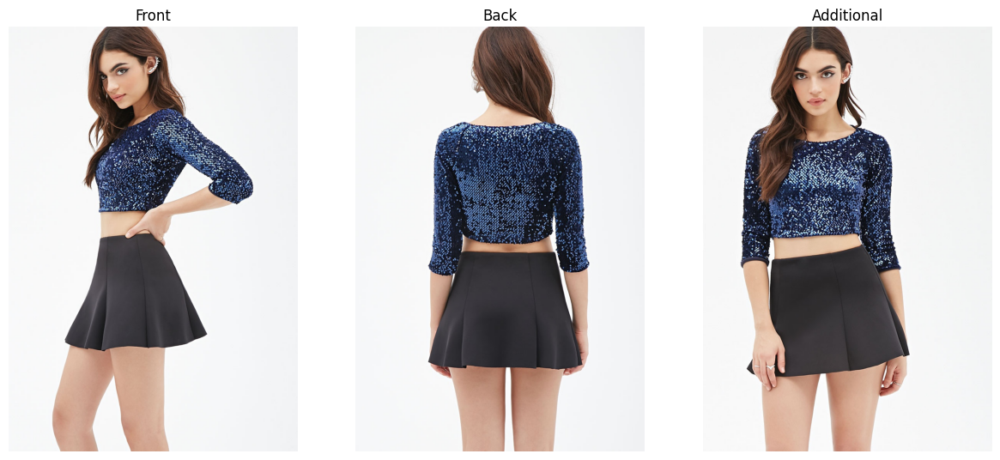


Article - 3


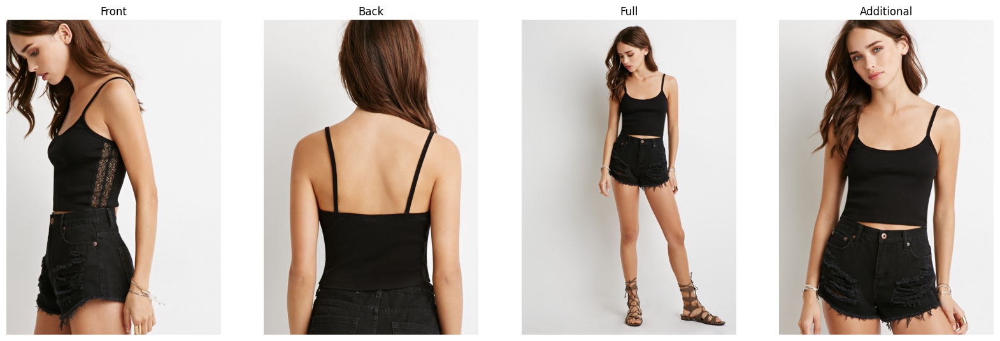


0: 640x448 1 trousers, 238.1ms
Speed: 4.5ms preprocess, 238.1ms inference, 6.0ms postprocess per image at shape (1, 3, 640, 640)


1/1 [==============================] - 0s 403ms/step


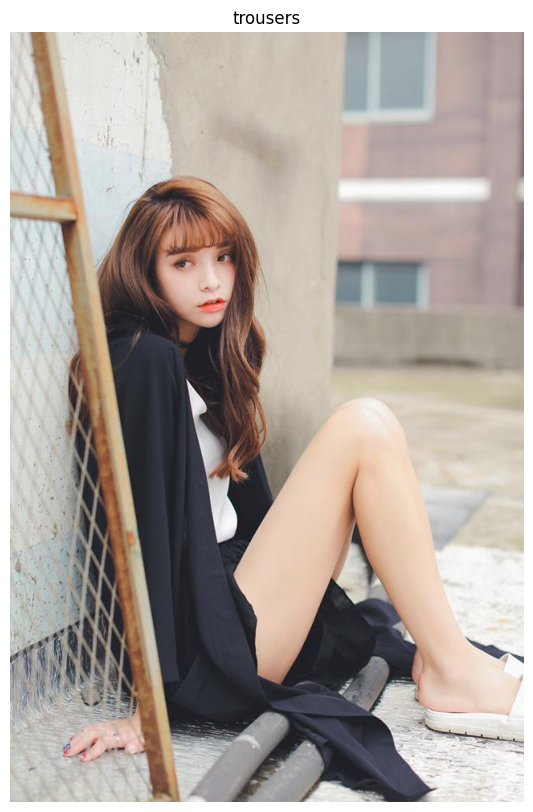


Article - 1


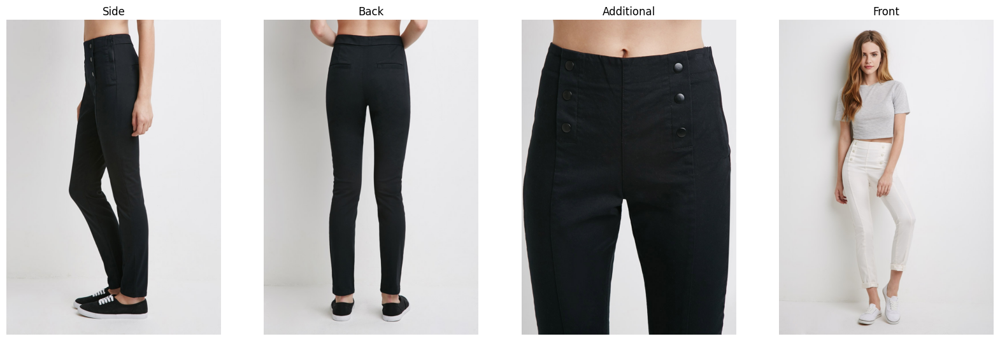


Article - 2


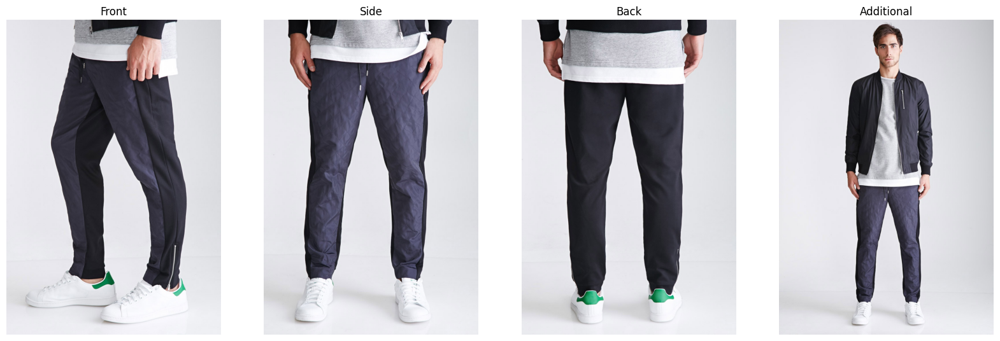


Article - 3


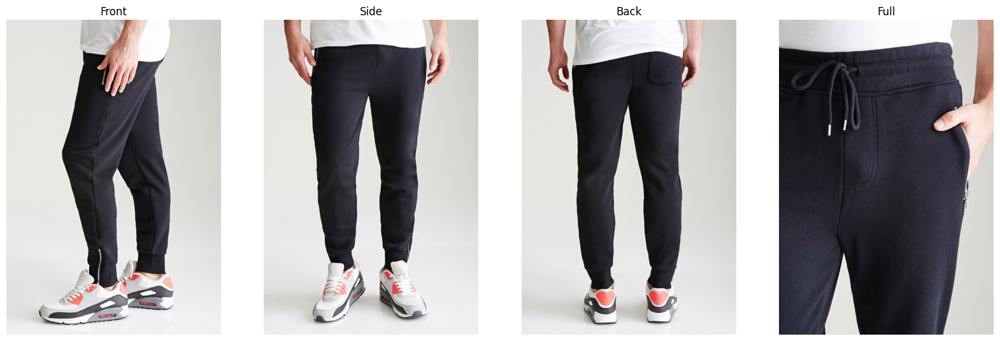


0: 640x480 1 short sleeve top, 1 trousers, 346.1ms
Speed: 8.4ms preprocess, 346.1ms inference, 8.0ms postprocess per image at shape (1, 3, 640, 640)


1/1 [==============================] - 0s 453ms/step


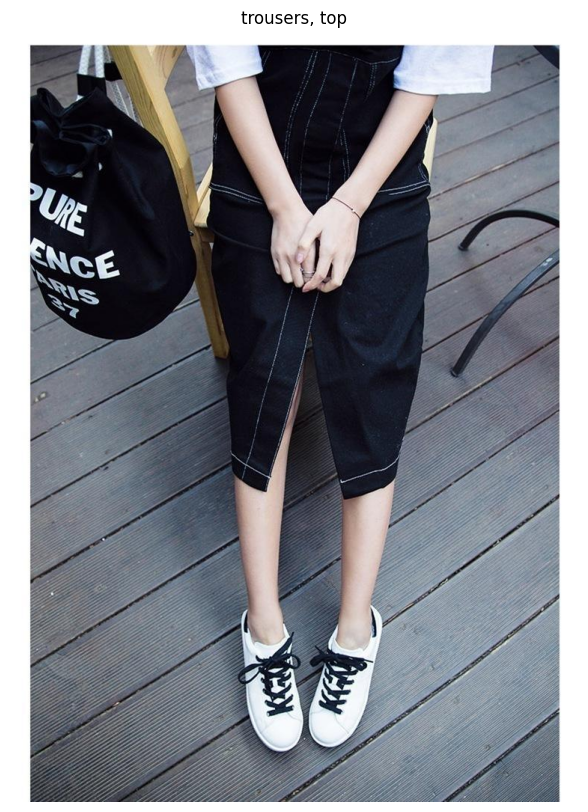


Article - 1


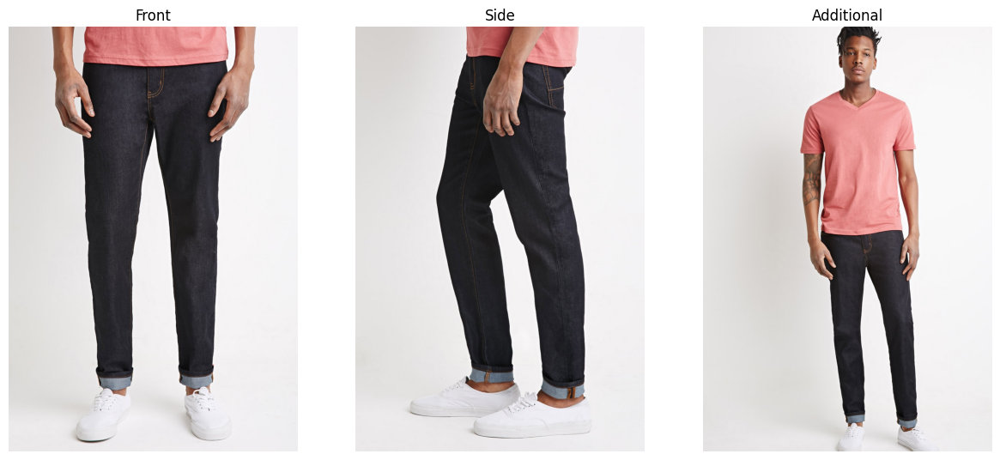


Article - 2


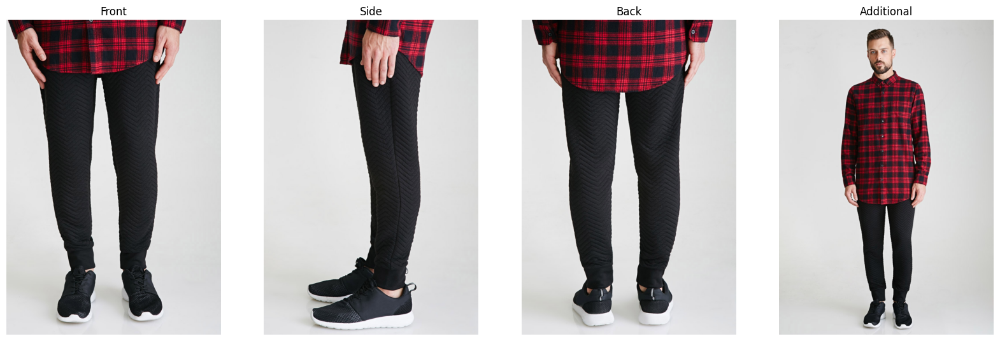


Article - 3


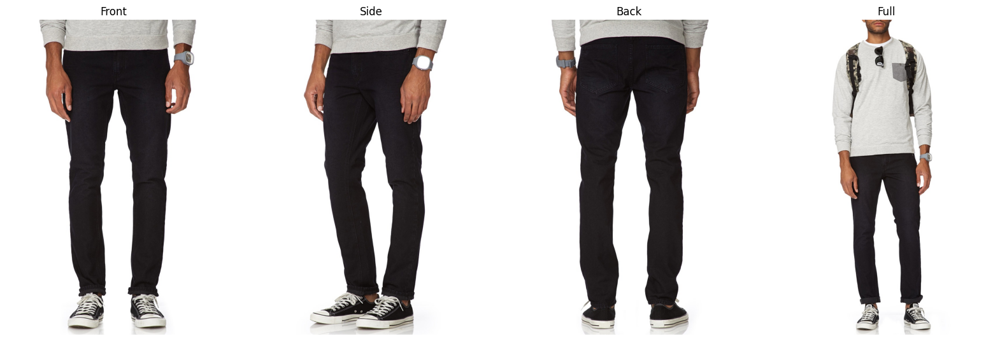


Article - 1


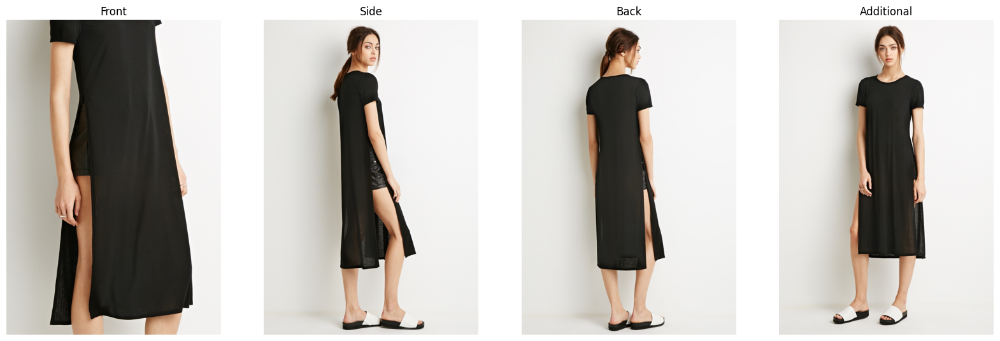


Article - 2


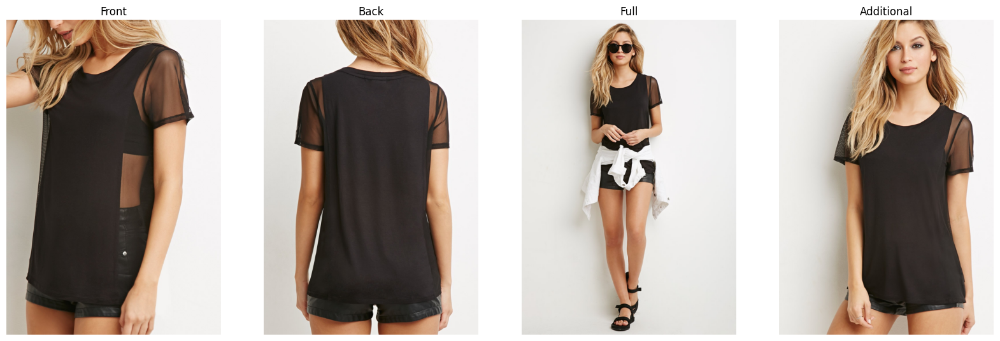


Article - 3


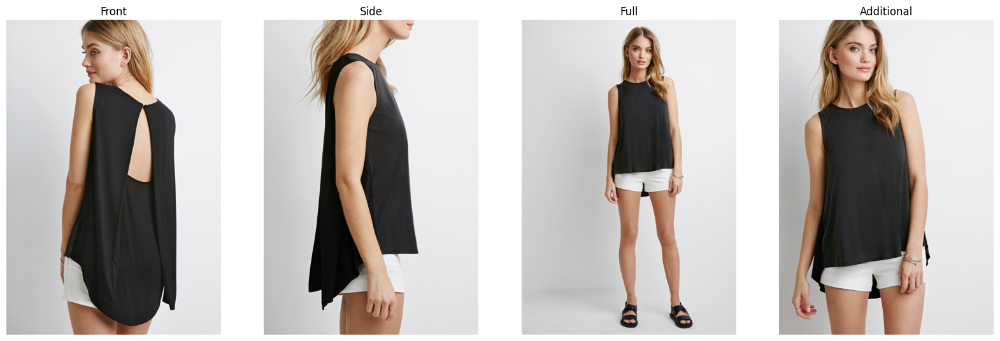

In [11]:
test_images = os.listdir('./data/images/test')
test_images = sample(test_images, 6)

for image in test_images:
    img_path = os.path.join(os.getcwd(), 'data', 'images', 'test', image)
    result = predict(img_path)
    plt.figure(figsize=(10, 10))
    plt.axis('off')
    plt.imshow(cv2.cvtColor(cv2.imread(img_path), cv2.COLOR_BGR2RGB))
    plt.title(', '.join(result.keys()))
    plt.show()
    if result != None:
        match = recommender(result, no_of_rec=3)
        show_recommendation(match)